In [1]:
%run ../../scripts/functions.py
import pandas as pd
import glob
import os
import numpy as np
import os
import matplotlib.pyplot as plt
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
import scanpy as sc
import anndata as ad
from sklearn.manifold import MDS
from scipy.stats import ttest_ind
import statsmodels.api as sm

# setting up enterotyper results

In [2]:
# Define the directory and correct file pattern
directory = "../../data/enterotyper"
file_pattern = os.path.join(directory, "*_EnterotypeAssignment_fuzzyClustering_k3.tsv")

# List matching files
files = sorted(glob.glob(file_pattern))

if not files:
    print("No matching files found.")
else:
    print(f"Found {len(files)} files. Concatenating...")

    # Read and concatenate files
    dfs = []
    for file in files:
        print(f"Reading file: {file}")
        df = pd.read_csv(file, sep="\t") 
        dfs.append(df)

    # Concatenate dataframes
    combined_df = pd.concat(dfs, axis=0, ignore_index=True)

    # Save the combined dataframe
    output_file = os.path.join(directory, "EnterotypeAssignment_fuzzyClustering_k3_combined_.tsv")
    combined_df.to_csv(output_file, sep="\t", index=False)

    print(f"Combined data saved to {output_file}")


Found 10 files. Concatenating...
Reading file: ../../data/enterotyper/0001_1000_EnterotypeAssignment_fuzzyClustering_k3.tsv
Reading file: ../../data/enterotyper/1001_2000_EnterotypeAssignment_fuzzyClustering_k3.tsv
Reading file: ../../data/enterotyper/2001_3000_EnterotypeAssignment_fuzzyClustering_k3.tsv
Reading file: ../../data/enterotyper/3001_4000_EnterotypeAssignment_fuzzyClustering_k3.tsv
Reading file: ../../data/enterotyper/4001_5000_EnterotypeAssignment_fuzzyClustering_k3.tsv
Reading file: ../../data/enterotyper/5001_6000_EnterotypeAssignment_fuzzyClustering_k3.tsv
Reading file: ../../data/enterotyper/6001_7000_EnterotypeAssignment_fuzzyClustering_k3.tsv
Reading file: ../../data/enterotyper/7001_8000_EnterotypeAssignment_fuzzyClustering_k3.tsv
Reading file: ../../data/enterotyper/8001_9000_EnterotypeAssignment_fuzzyClustering_k3.tsv
Reading file: ../../data/enterotyper/9001_9166_EnterotypeAssignment_fuzzyClustering_k3.tsv
Combined data saved to ../../data/enterotyper/EnterotypeA

In [3]:
species_sample_names = pd.read_csv(f'{directory}/samples_column_names.csv', sep=',', index_col=0, header=0)

# setting up AA results

In [4]:
figures_path = '../../figures/exp03/6_figures'
data_path = '../../data/only_healthy_data'
pathways = pd.read_csv(f'{data_path}/batchfix_paths_healthy_samples_pathway_counts.csv', sep=',', index_col=0, header=0)
metadata = pd.read_csv(f'{data_path}/batchfix_paths_healthy_samples_pathway_metadata.csv', sep=',', index_col=0, header=0)
metadata.rename(columns={'Global.Region': 'Global Region'}, inplace=True)

In [5]:
# Set 'sample_id' as the index of combined_df
combined_df.sample_id = species_sample_names.index
combined_df.set_index("sample_id", inplace=True)

# Add columns from combined_df to metadata by aligning indices
metadata = metadata.join(combined_df, how="left")
metadata

,study,sample_id,subject_id,body_site,antibiotics_current_use,disease,age,age_category,gender,country,...,number_reads,minimum_read_length,median_read_length,NCBI_accession,BMI,Bact_Phoc,Prevotella,Firmicutes,enterotype,Enterotype_Dysbiosis_Score
ERR688551,PRJEB7774,SID31519,SID31519,stool,no,healthy,65.0,adult,Male,Austria,...,47430300.0,30.0,96.0,ERR688551;ERR688404,28.90,0.118250,0.726887,0.164304,Prevotella,0.519272
ERR688544,PRJEB7774,SID31452,SID31452,stool,no,healthy,66.0,senior,Female,Austria,...,52825648.0,30.0,94.0,ERR688544;ERR688397,21.70,0.322461,0.138132,0.529430,Firmicutes,0.550387
ERR710432,PRJEB7774,SID532915,SID532915,stool,no,healthy,43.0,adult,Female,Austria,...,51594677.0,30.0,96.0,ERR710432;ERR710423,22.65,0.559256,0.119387,0.355825,Bact_Phoc,0.538581
ERR688610,PRJEB7774,SID530295,SID530295,stool,no,healthy,70.0,senior,Female,Austria,...,58306781.0,30.0,93.0,ERR688610;ERR688463,22.67,0.297931,0.159205,0.514832,Firmicutes,0.579202
ERR688646,PRJEB7774,SID531414,SID531414,stool,no,healthy,46.0,adult,Male,Austria,...,54863689.0,30.0,96.0,ERR688646;ERR688499,23.15,0.497871,0.114715,0.401602,Bact_Phoc,0.667364
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
SRR8146942,PRJNA421881,SIDVOV72_metag,VOV72,stool,NaN,healthy,28.0,adult,Female,Italy,...,36988043.0,100.0,100.0,SRR8146942,22.70,0.504852,0.121356,0.436340,Bact_Phoc,0.652718
SRR6367587,PRJNA421881,SID22.TO.O.new,22TO,stool,NaN,healthy,31.0,adult,Male,Italy,...,23021624.0,100.0,100.0,SRR6367587,23.52,0.276319,0.289709,0.501647,Firmicutes,0.605229
SRR8146941,PRJNA421881,SIDVOV66_metag,VOV66,stool,NaN,healthy,33.0,adult,Female,Italy,...,32925755.0,100.0,100.0,SRR8146941,24.60,0.487716,0.148836,0.366220,Bact_Phoc,0.688670
SRR8146955,PRJNA421881,SID26.PR.V_metag,26PRV,stool,NaN,healthy,25.0,adult,Male,Italy,...,45162938.0,100.0,100.0,SRR8146955,22.40,0.516019,0.124108,0.371435,Bact_Phoc,0.629291


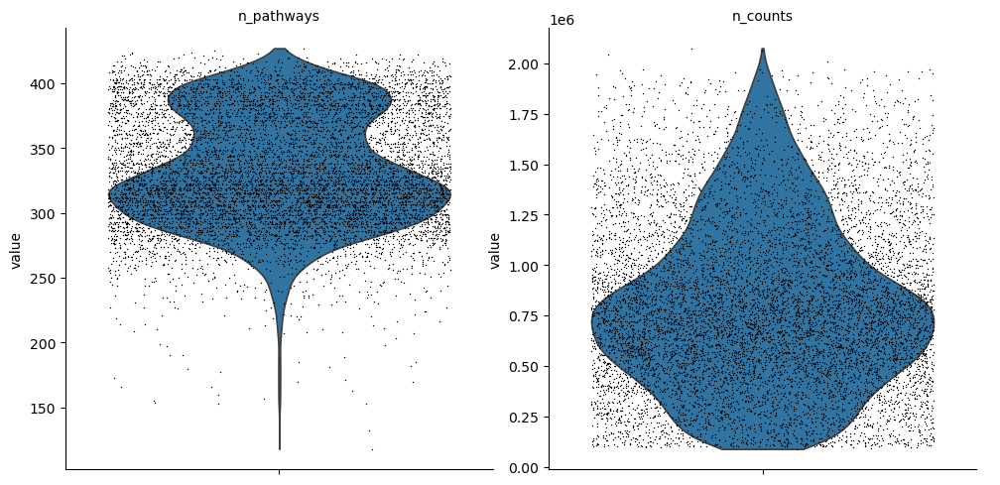

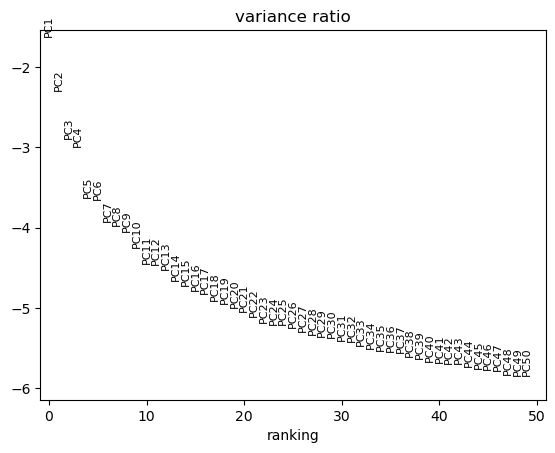

/home/UWO/mmeawad/anaconda3/envs/test4.2/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
2025-01-23 19:16:07.113179: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  SSE4.1 SSE4.2 AVX AVX2 AVX512F AVX512_VNNI AVX512_BF16 AVX_VNNI AMX_TILE AMX_INT8 AMX_BF16 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2025-01-23 19:16:07.181728: I tensorflow/core/util/util.cc:169] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
/ho

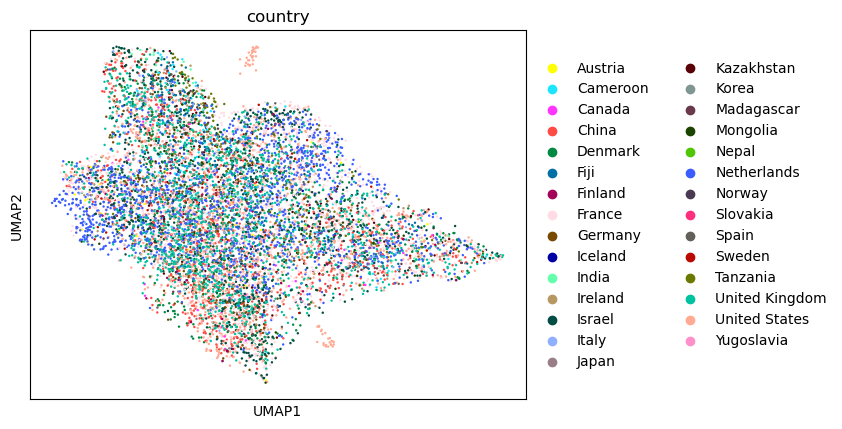

/home/UWO/mmeawad/anaconda3/envs/test4.2/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


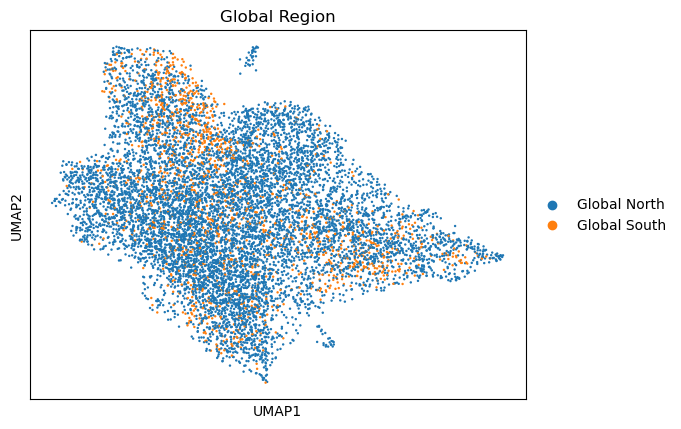

/home/UWO/mmeawad/anaconda3/envs/test4.2/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


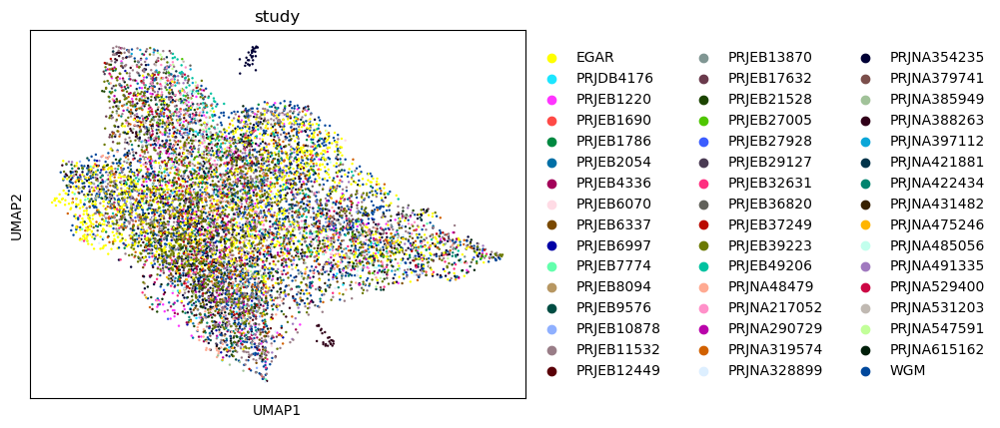

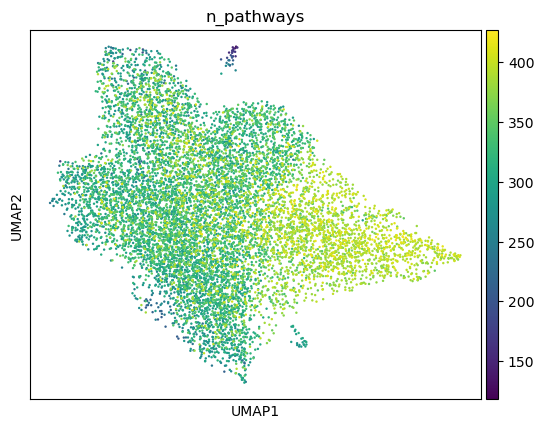

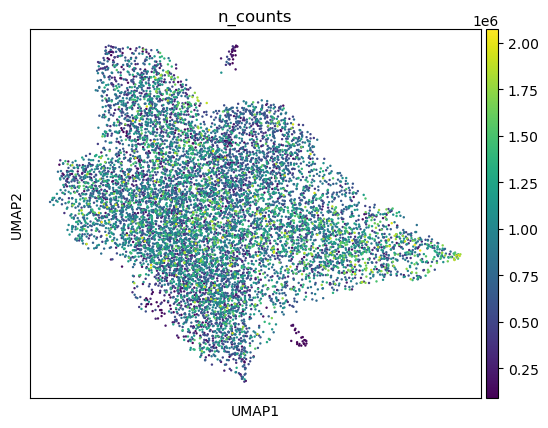

In [6]:
concat_ad = convertToAnnData(pathways, metadata)

In [7]:
import pickle
with open('../../data/scAAnet_output/clean_100_rs.pkl', 'rb') as f:
    clean_100_states = pickle.load(f)

dist = 'nb'
K = 3

counts = concat_ad.copy()

recon = clean_100_states[(3, 53)]['recon']
usage = clean_100_states[(3, 53)]['usage']
spectra = clean_100_states[(3, 53)]['spectra']
gene_score = clean_100_states[(3, 53)]['gene_score']
gene_score.index = pathways.index

usage = pd.DataFrame(usage, index=counts.obs.index, columns = np.arange(1,K+1))
usage.columns = ['type3', 'type1', 'type2']
desired_order = ['type1', 'type2', 'type3']
usage = usage[desired_order]

gene_score.columns = ['type3', 'type1', 'type2']
desired_order = ['type1', 'type2', 'type3']
gene_score = gene_score[desired_order]

spectra = pd.DataFrame(np.transpose(spectra), index=counts.var.index, columns=usage.columns)
recon = pd.DataFrame(recon, index=counts.obs.index, columns=counts.var.index)

usage = usage.apply(pd.to_numeric, errors='coerce').astype('float64')

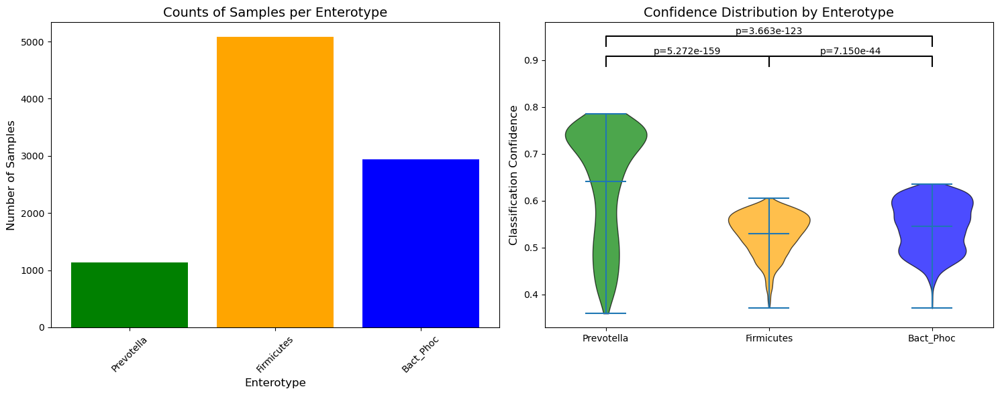

In [8]:
# Reorder enterotypes for consistent plotting order
enterotype_order = ["Prevotella", "Firmicutes", "Bact_Phoc"]
color_order = ['green', 'orange', 'blue']

# Count the number of samples for each enterotype (reordered)
enterotype_counts = combined_df['enterotype'].value_counts().reindex(enterotype_order)

# Prepare data for violin plot (reordered by enterotype)
data_to_plot = [
    combined_df.loc[combined_df["enterotype"] == "Prevotella", "Prevotella"].dropna(),
    combined_df.loc[combined_df["enterotype"] == "Firmicutes", "Firmicutes"].dropna(),
    combined_df.loc[combined_df["enterotype"] == "Bact_Phoc", "Bact_Phoc"].dropna()
]

# Perform pairwise t-tests
ttest_results = {}
for i, group1 in enumerate(data_to_plot):
    for j, group2 in enumerate(data_to_plot):
        if i < j:
            stat, pval = ttest_ind(group1, group2, equal_var=False)
            ttest_results[f"{enterotype_order[i]} vs {enterotype_order[j]}"] = pval

# Create a figure with two subplots: bar plot and violin plot
fig, axes = plt.subplots(1, 2, figsize=(15, 6), dpi=100)

# Bar Plot: Counts of each enterotype
axes[0].bar(enterotype_order, enterotype_counts.values, color=color_order)
axes[0].set_title("Counts of Samples per Enterotype", fontsize=14)
axes[0].set_ylabel("Number of Samples", fontsize=12)
axes[0].set_xlabel("Enterotype", fontsize=12)
axes[0].tick_params(axis='x', rotation=45)

# Violin Plot: Confidence distributions
parts = axes[1].violinplot(data_to_plot, showmeans=True, showextrema=True)
for i, pc in enumerate(parts['bodies']):
    pc.set_facecolor(color_order[i])
    pc.set_edgecolor('black')
    pc.set_alpha(0.7)
axes[1].set_xticks([1, 2, 3])
axes[1].set_xticklabels(enterotype_order)
axes[1].set_ylabel("Classification Confidence", fontsize=12)
axes[1].set_title("Confidence Distribution by Enterotype", fontsize=14)

# Add t-test results with journal-style lines
y_max = max([group.max() for group in data_to_plot]) * 1.1
offset = 0.05 * y_max  # Vertical offset for lines
for i, group1 in enumerate(data_to_plot):
    for j, group2 in enumerate(data_to_plot):
        if i < j:
            pval = ttest_results[f"{enterotype_order[i]} vs {enterotype_order[j]}"]
            x1, x2 = i + 1, j + 1
            y = y_max + (j - i) * offset
            # Draw line
            axes[1].plot([x1, x1, x2, x2], [y - offset / 2, y, y, y - offset / 2], lw=1.5, color='black')
            # Add p-value text
            axes[1].text((x1 + x2) / 2, y, f"p={pval:.3e}",
                         ha='center', va='bottom', fontsize=10)

# Adjust layout and save the plot as PDF
fig.tight_layout()
pdf_file = f"{figures_path}/figure4A_samples_enterotypes_barplot_violin.pdf"
plt.savefig(pdf_file, format='pdf')
plt.show()

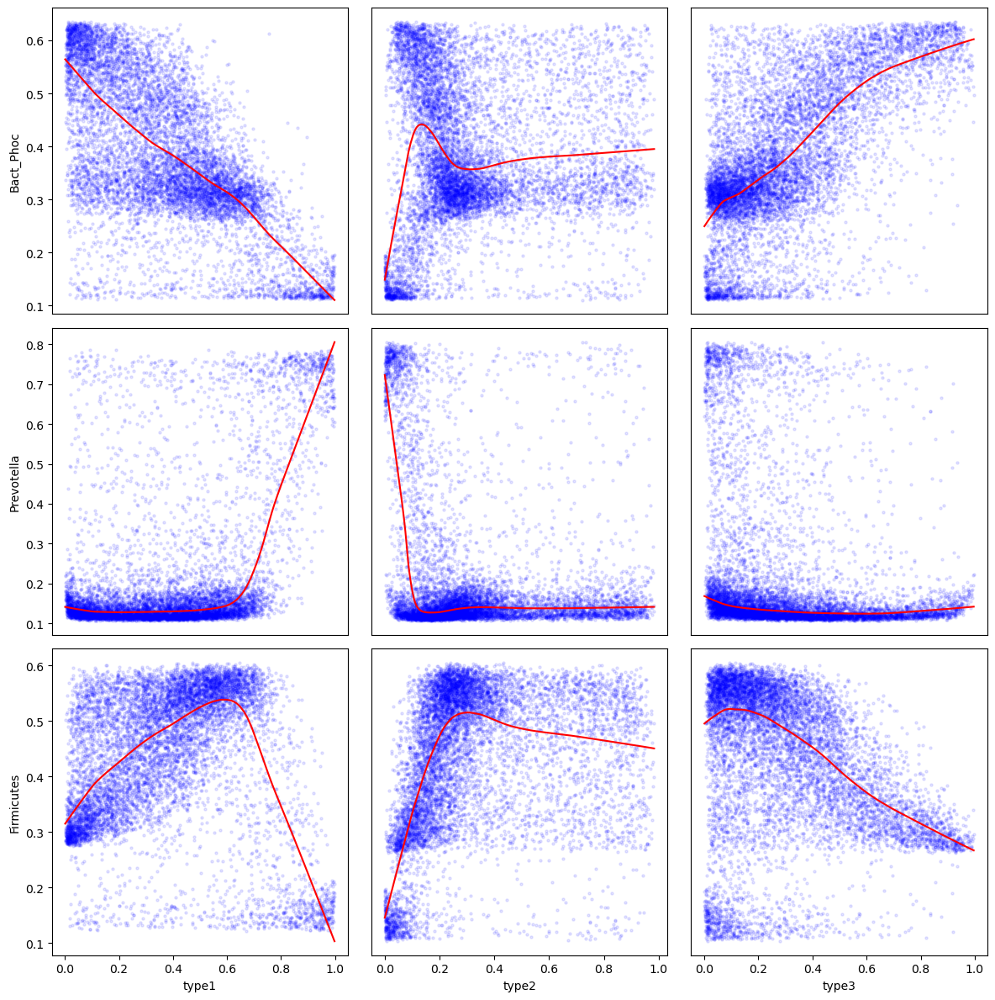

In [9]:
# Determine the indices that are present in both usage and combined_df
common_indices = usage.index.intersection(combined_df.index)
# Filter the usage dataframe to include only these indices
filtered_usage = usage.loc[common_indices]
filtered_usage = filtered_usage.join(
    combined_df[['Bact_Phoc', 'Prevotella', 'Firmicutes']],
    how='inner'
)

# Specify archetypes (x-axis) and enterotypes (y-axis)
types = ['type1', 'type2', 'type3']
enterotypes = ['Bact_Phoc', 'Prevotella', 'Firmicutes']

# Create a grid of subplots
fig, axes = plt.subplots(len(enterotypes), len(types), figsize=(12, 12), dpi=100)
plt.subplots_adjust(hspace=0.4, wspace=0.4)

# Loop through rows (enterotypes) and columns (types) of the grid
for i, var1 in enumerate(enterotypes):  # y-axis variables
    for j, var2 in enumerate(types):  # x-axis variables
        ax = axes[i, j]
        # Scatter plot
        ax.scatter(filtered_usage[var2], filtered_usage[var1], s=5, alpha=0.1, color='blue', label='Data Points')

        # Add LOWESS curve
        lowess = sm.nonparametric.lowess(filtered_usage[var1], filtered_usage[var2], frac=0.3)
        ax.plot(lowess[:, 0], lowess[:, 1], color='red', label='LOWESS Curve')

        # Set axis labels only on the outer edges
        if i == len(enterotypes) - 1:
            ax.set_xlabel(var2, fontsize=10)
        else:
            ax.set_xticks([])
        
        if j == 0:
            ax.set_ylabel(var1, fontsize=10)
        else:
            ax.set_yticks([])

# Save and show the plot in SVG format
plt.tight_layout()
pdf_file = f"{figures_path}/figure4B_archetypes_vs_enterotypes_scatter.pdf"
plt.savefig(pdf_file, format='pdf')
plt.show()


In [10]:
data_at = usage.to_numpy()
embedding = MDS(n_components=2, random_state=42)
Y_mds_ats = embedding.fit_transform(np.transpose(spectra))
Y_mds_data = data_at @ Y_mds_ats
(fig, ax) = plt.subplots(1,3,figsize=(25, 8), dpi=600)
plt.suptitle('')
for i in range(1):
    for j in range(3):
        ax[j].set_xticks([])
        ax[j].set_yticks([])
        ax[j].set_xlabel('MDS1', fontsize=15)
        ax[j].set_ylabel('MDS2', fontsize=15)
        g = ax[j].scatter(Y_mds_data[:,0], Y_mds_data[:,1], s=1, alpha=0.5,
                   cmap='inferno', c=usage.iloc[:, i*5+j], vmin=0, vmax=1)
        ax[j].set_title('GEP %d' % (i*5+j+1), fontsize=12)
        ax[j].scatter(Y_mds_ats[:,0], Y_mds_ats[:,1], s=200, c='r', zorder=3)
        for k in range(Y_mds_ats.shape[0]):
            ax[j].text(Y_mds_ats[k,0], Y_mds_ats[k,1], k+1, horizontalalignment='center', verticalalignment='center', fontdict={'color': 'white','size':15,'weight':'bold'}, zorder=4)
    plt.colorbar(g, ax=ax[j])

fig.tight_layout()

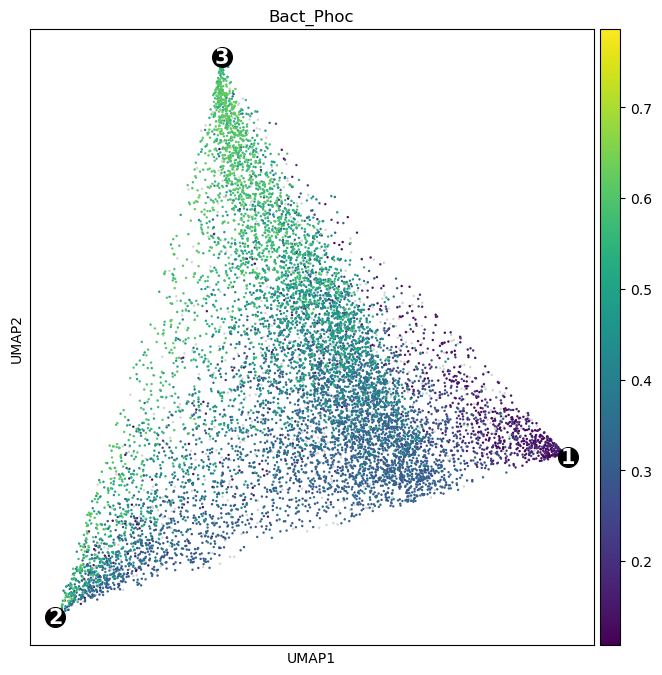

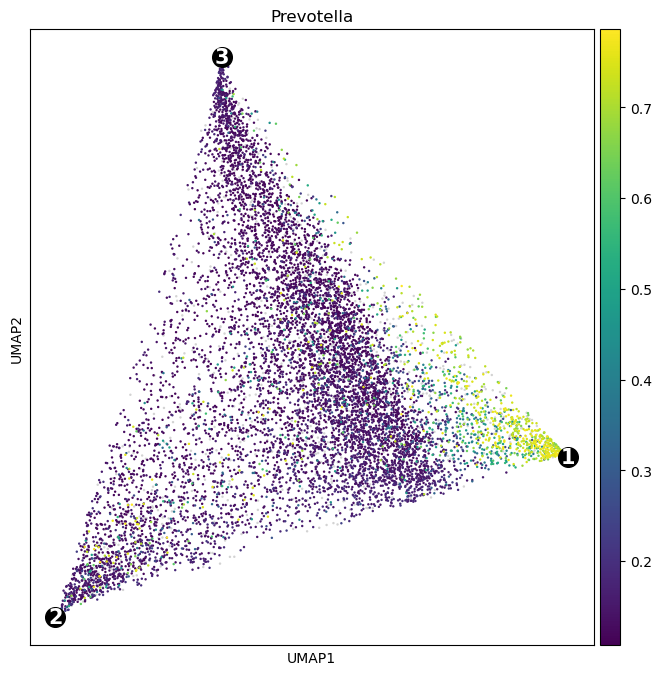

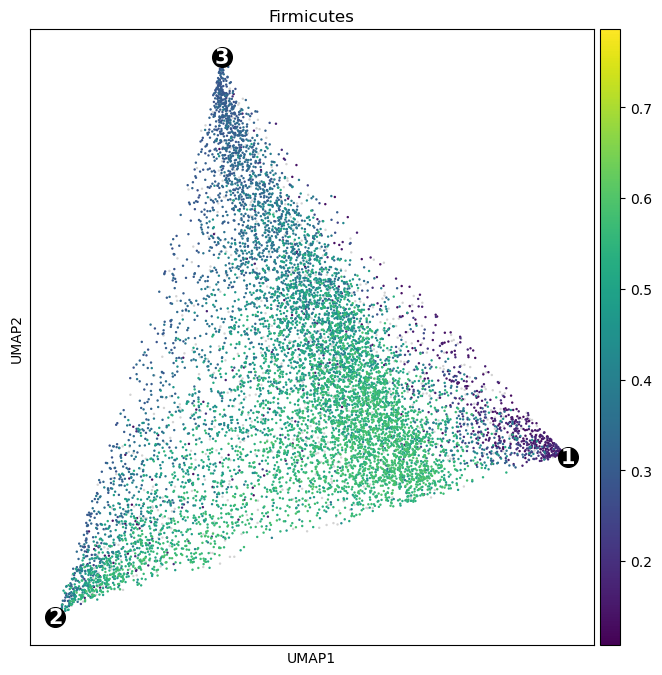

In [11]:
# Define the columns for consistent color scaling
target_features = ['Bact_Phoc', 'Prevotella', 'Firmicutes']

# Determine global min and max across these features
vmin = combined_df[target_features].min().min()
vmax = combined_df[target_features].max().max()

# Iterate through all features
for j in target_features:
    concat_ad.obsm['X_umap'] = Y_mds_data  # Assign the MDS data to UMAP
    fig, ax = plt.subplots(1, 1, figsize=(8, 8))

    # Plot the MDS archetypes
    for i in range(K):
        ax.scatter(
            Y_mds_ats[i, 0], Y_mds_ats[i, 1],
            s=200, c='k', zorder=3
        )
        ax.text(
            Y_mds_ats[i, 0], Y_mds_ats[i, 1], i + 1,
            horizontalalignment='center',
            verticalalignment='center',
            fontdict={'color': 'white', 'size': 15, 'weight': 'bold'},
            zorder=4
        )

    sc.pl.umap(concat_ad, color=j, ax=ax, legend_fontsize=12, vmin=vmin, vmax=vmax, save=f"figure4C_AA_plot_{j}.pdf")

import shutil
temp = "./figures"
# Check if the source directory exists
if os.path.exists(temp):
    # Rename files to remove the "umap" prefix and move them to the destination directory
    for file_name in os.listdir(temp):
        full_file_name = os.path.join(temp, file_name)
        if os.path.isfile(full_file_name):  # Check if it's a file
            # Remove "umap" prefix if it exists
            new_file_name = file_name.replace("umap", "", 1)
            destination = os.path.join(figures_path, new_file_name)
            shutil.move(full_file_name, destination)
    
    # Remove the empty figures directory
    if not os.listdir(temp):  # Check if the directory is empty
        os.rmdir(temp)  # Remove the directory
else:
    print(f"The directory {temp} does not exist.")

